# Trend COVID-19 Italia

Analisi dati relativi all'epidemia di COVID-19 scoppiata nel 2020 in Italia.

Fonte dati: <https://github.com/pcm-dpc/COVID-19>

Codice rilasciato in licenza MIT: <https://opensource.org/licenses/MIT>

Autore: *Emanuele Zeppieri*

In [1]:
import itertools
import functools
import os
import math

import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.patheffects as pe

DEFAULT_FONT_SIZE = 13

from matplotlib import rcParams
rcParams['font.family'] = 'serif'
rcParams['font.serif'] = ['Century Schoolbook']
rcParams['font.size'] = DEFAULT_FONT_SIZE
rcParams['figure.dpi'] = 300
rcParams['text.usetex'] = False
from matplotlib.markers import CARETDOWNBASE, CARETUPBASE
import matplotlib.dates as mdates

import datetime as dt
from datetime import date, datetime, timedelta

import locale
locale.setlocale(locale.LC_ALL, 'it_IT')

from ETL_utilities import it_data_load, fix_2020_03_10, add_delta_growth_perc, add_ra, add_ra_days
from formatting_utilities import format_dates, format_dates_from_numbers, LegendTitle
from file_utilities import save_in_dir
from common_data import REGIONS_POP

%load_ext autoreload
%autoreload 2

# Global constants
# PLEASE CUSTOMIZE
OUTPUT_PATH = '../output'

In [2]:
# Caricamento dei dati dalla Protezione Civile
ds_it = it_data_load()

# Sanity check
ds_it.tail(10)

,stato,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,nuovi_positivi,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,note_it,note_en
data,,,,,,,,,,,,,,,
2020-04-29,ITA,19210,1795,21005,83652,104657,-548,2086,71252,27682,203591,1910761,1313460.0,NaN,NaN
2020-04-30,ITA,18149,1694,19843,81708,101551,-3106,1872,75945,27967,205463,1979217,1354901.0,NaN,NaN
2020-05-01,ITA,17569,1578,19147,81796,100943,-608,1965,78249,28236,207428,2053425,1398633.0,dc-IT-0015,dc-EN-0015
2020-05-02,ITA,17357,1539,18896,81808,100704,-239,1900,79914,28710,209328,2108837,1429864.0,dc-IT-0017,dc-EN-0017
2020-05-03,ITA,17242,1501,18743,81436,100179,-525,1389,81654,28884,210717,2153772,1456911.0,NaN,NaN
2020-05-04,ITA,16823,1479,18302,81678,99980,-199,1221,82879,29079,211938,2191403,1479910.0,dc-IT-0019,dc-EN-0019
2020-05-05,ITA,16270,1427,17697,80770,98467,-1513,1075,85231,29315,213013,2246666,1512121.0,NaN,NaN
2020-05-06,ITA,15769,1333,17102,74426,91528,-6939,1444,93245,29684,214457,2310929,1549892.0,dc-IT-0021,dc-EN-0021
2020-05-07,ITA,15174,1311,16485,73139,89624,-1904,1401,96276,29958,215858,2381288,1563557.0,dc-IT-0023,dc-EN-0023


In [3]:
# Correzione dati errati 2020-03-10 nazionali
fix_2020_03_10(ds_it)

In [4]:
add_delta_growth_perc(ds_it)
add_ra(ds_it)

In [5]:
# Check
#ds_it.head()
ds_it.loc[:, [
    'totale_casi', 'totale_casi_DELTA', 'totale_casi_DELTA_RA_7', 'tamponi', 'tamponi_DELTA', 'casi_testati_DELTA',
    'tamponi_negativi', 'dimessi_guariti', 'dimessi_guariti_DELTA', 'deceduti', 'deceduti_DELTA', 'positive_test_RATIO',
    'terapia_intensiva_RATIO', 'terapia_intensiva_CUM', 'totale_ospedalizzati_RATIO'
]].tail(10)

,totale_casi,totale_casi_DELTA,totale_casi_DELTA_RA_7,tamponi,tamponi_DELTA,casi_testati_DELTA,tamponi_negativi,dimessi_guariti,dimessi_guariti_DELTA,deceduti,deceduti_DELTA,positive_test_RATIO,terapia_intensiva_RATIO,terapia_intensiva_CUM,totale_ospedalizzati_RATIO
data,,,,,,,,,,,,,,,
2020-04-29,203591,2086.0,1996.714286,1910761,63827.0,38589.0,61741.0,71252,2311.0,27682,323.0,0.032682,0.017151,149447,0.200703
2020-04-30,205463,1872.0,1863.142857,1979217,68456.0,41441.0,66584.0,75945,4693.0,27967,285.0,0.027346,0.016681,151141,0.195399
2020-05-01,207428,1965.0,1789.142857,2053425,74208.0,43732.0,72243.0,78249,2304.0,28236,269.0,0.026480,0.015633,152719,0.189681
2020-05-02,209328,1900.0,1644.000000,2108837,55412.0,31231.0,53512.0,79914,1665.0,28710,474.0,0.034289,0.015282,154258,0.187639
2020-05-03,210717,1389.0,1552.285714,2153772,44935.0,27047.0,43546.0,81654,1740.0,28884,174.0,0.030911,0.014983,155759,0.187095
2020-05-04,211938,1221.0,1485.000000,2191403,37631.0,22999.0,36410.0,82879,1225.0,29079,195.0,0.032447,0.014793,157238,0.183057
2020-05-05,213013,1075.0,1393.857143,2246666,55263.0,32211.0,54188.0,85231,2352.0,29315,236.0,0.019452,0.014492,158665,0.179725
2020-05-06,214457,1444.0,1309.500000,2310929,64263.0,37771.0,62819.0,93245,8014.0,29684,369.0,0.022470,0.014564,159998,0.186850
2020-05-07,215858,1401.0,1293.600000,2381288,70359.0,13665.0,68958.0,96276,3031.0,29958,274.0,0.019912,0.014628,161309,0.183935


In [6]:
SUBTITLE = 'Fonte: Protezione Civile Italia - https://github.com/pcm-dpc/COVID-19 (dati del 10/03/2020 corretti)\nCodice libero: https://github.com/emazep/COVID-19-Statistics'
SUBTITLE_NO_CORR = 'Fonte: Protezione Civile Italia - https://github.com/pcm-dpc/COVID-19\nCodice libero: https://github.com/emazep/COVID-19-Statistics'
SUBTITLE_NO_CORR_ISTAT = 'Fonte: Protezione Civile Italia - https://github.com/pcm-dpc/COVID-19; Istat - http://dati.istat.it/Index.aspx?DataSetCode=DCIS_POPRES1\nCodice libero: https://github.com/emazep/COVID-19-Statistics'

common_plt_params = {'markersize':8, 'linewidth':4}
small_plt_params = {'markersize':6, 'linewidth':3}

DATE_SIZE = 9

GLOBAL_SLACK = 0.54
TAMPONI_MEAN_SLACK = 0.0064

pe_outline = pe.withStroke(linewidth=5, foreground='black')
pe_shadow = pe.SimpleLineShadow(offset=(0,-4), alpha=0.4)
pe_normal = pe.Normal()

In [7]:
MIN_DATE = ds_it.index.min()
MAX_DATE = ds_it.index.max()

def set_xlim(ax, slack=0):
    ax.set_xlim(left=MIN_DATE, right=MAX_DATE)
    ax.set_xlim(ax.get_xlim()[0]-slack, ax.get_xlim()[1]+slack)

def set_xlim_num(ax, slack=0, min_x=0, max_x=200):
    ax.set_xlim(left=min_x, right=max_x)
    ax.set_xlim(ax.get_xlim()[0]-slack, ax.get_xlim()[1]+slack)

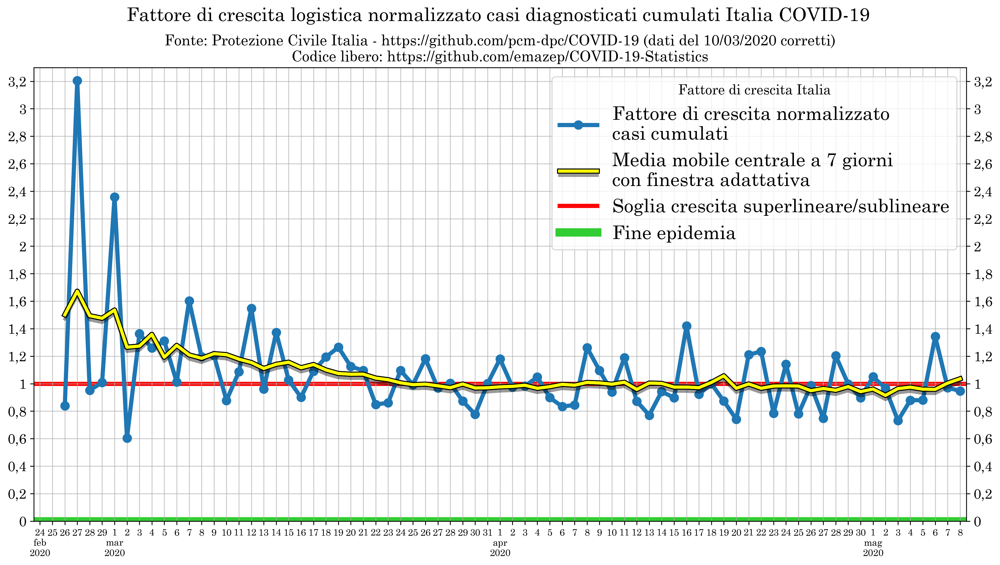

In [8]:
# Growth factor
SLACK = 0.5
ALPHA = 0.7
LINE_COLOR = 'yellow'
BORDER_COLOR = 'black'

ax = ds_it.plot(
    y='growth_factor_cum_infected', label='Fattore di crescita normalizzato\ncasi cumulati', **common_plt_params, marker='o', figsize=(16, 8), zorder=3
)
ax.plot(
    ds_it.index, ds_it['growth_factor_cum_infected_RA_7'], label='Media mobile centrale a 7 giorni\ncon finestra adattativa',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)
plt.axhline(y=1, color='red', linewidth=4, zorder=0, alpha=1, label='Soglia crescita superlineare/sublineare')
plt.axhline(y=0, color='limegreen', linewidth=8, zorder=0, alpha=1, label='Fine epidemia')

set_xlim(ax, SLACK)
ax.set_ylim(bottom=0)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)

ax.yaxis.set_major_locator(ticker.MultipleLocator(0.2))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylim(top=3.3)

ax.grid(which='both', alpha=ALPHA)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title="Fattore di crescita Italia", fontsize=18)

ax.set_title(SUBTITLE, fontsize=14)
plt.suptitle('     Fattore di crescita logistica normalizzato casi diagnosticati cumulati Italia COVID-19', fontsize=18)

fig_growth = plt.gcf()

plt.show()

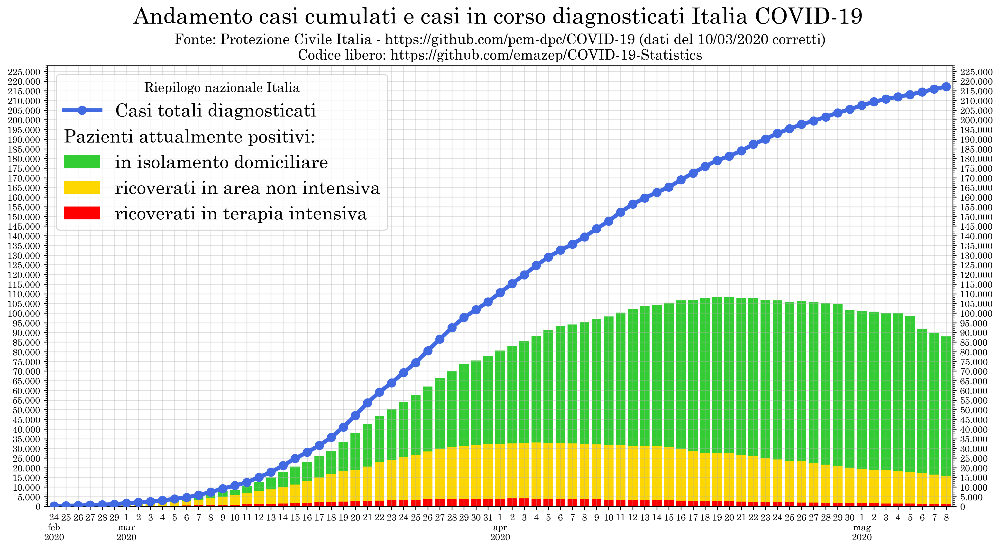

In [9]:
# Cases trend
SLACK = 0.54

ALPHA = 0.4

ax = ds_it.plot(y='totale_casi', label='Casi totali diagnosticati', **common_plt_params, marker='o', figsize=(16, 8), zorder=3, color='royalblue')
ax.bar(ds_it.index, ds_it['isolamento_domiciliare'], label='in isolamento domiciliare', bottom=ds_it['terapia_intensiva']+ds_it['ricoverati_con_sintomi'], color='limegreen')
ax.bar(ds_it.index, ds_it['ricoverati_con_sintomi'], label='ricoverati in area non intensiva', bottom=ds_it['terapia_intensiva'], color='gold')
ax.bar(ds_it.index, ds_it['terapia_intensiva'], label='ricoverati in terapia intensiva', color='red')

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both', alpha=ALPHA)

ax.yaxis.grid(True, which='major', alpha=ALPHA)
ax.yaxis.set_major_locator(ticker.MultipleLocator(5_000))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(1_000))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=9)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

handles, labels = ax.get_legend_handles_labels()
handles.insert(1, 'Pazienti attualmente positivi:')
labels.insert(1, '')
ax.legend(handles, labels, title="Riepilogo nazionale Italia", fontsize=18, handler_map={str: LegendTitle({'fontsize': 18})})

ax.set_title(SUBTITLE, fontsize=14)
plt.suptitle('    Andamento casi cumulati e casi in corso diagnosticati Italia COVID-19', fontsize=22)

fig_trend = plt.gcf()

plt.show()

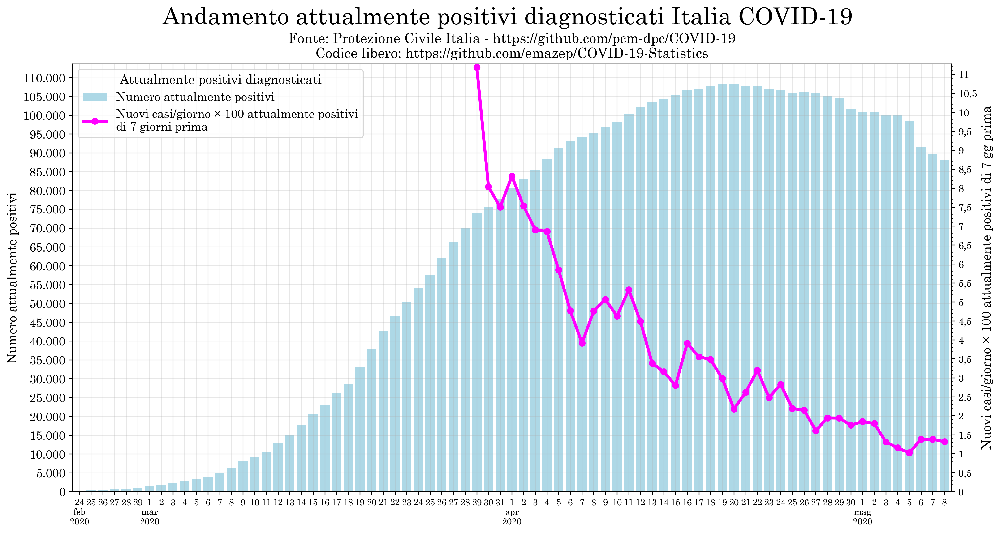

In [10]:
# Current

ALPHA = 0.3
SLACK = 0.6

_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['totale_positivi'], label='Numero attualmente positivi', color='lightblue')

ax2 = ax.twinx()

'''
ax2.plot(
    ds_it.index, ds_it['totale_casi_DELTA_RATIO'], label='Nuovi casi/giorno × 100 attualmente positivi',
    linewidth=2.5, markersize=5, marker='o', zorder=3, color='darkviolet'
)
'''

x = ds_it.index
y = ds_it['totale_casi_DELTA_RATIO-7']
ax2.plot(
    x, y, label='Nuovi casi/giorno × 100 attualmente positivi\ndi 7 giorni prima',
    **small_plt_params, marker='o', zorder=3, color='magenta'
)

'''
CLIP_DATE = dt.date(2020, 3, 9)
for i, j in zip(x,y):
    if i < CLIP_DATE or math.isnan(j):
        continue
    YSLACK = -0.075 if i == CLIP_DATE else 0.05
    ax2.annotate(
        f'{round(j*100,1):n}', xy=(i,j), xytext=(i, j+YSLACK),
        fontsize=8, bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.5), annotation_clip=True
    )
'''

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))

ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5000))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='major', labelsize=12)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Numero attualmente positivi')

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('   Andamento attualmente positivi diagnosticati Italia COVID-19', fontsize=24)

ax2.set_ylabel('Nuovi casi/giorno × 100 attualmente positivi di 7 gg prima')

ax2.set_ylim(bottom=0, top=0.1128)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.005))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x*100:n}'))
ax2.tick_params(axis='y', which='major', labelsize=10)

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Attualmente positivi diagnosticati',
    fontsize=12, loc='upper left'
)

fig_current = plt.gcf()

plt.show()

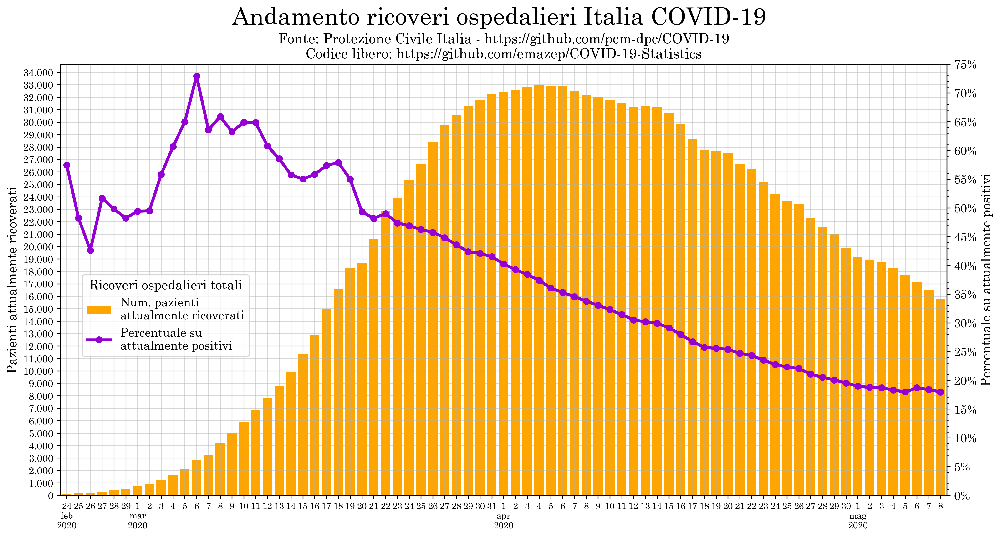

In [11]:
ALPHA = 0.5
SLACK = 0.54

# Tests trend
_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['totale_ospedalizzati'], label='Num. pazienti\nattualmente ricoverati', color='orange')

ax2 = ax.twinx()

ax2.plot(
    ds_it.index, ds_it['totale_ospedalizzati_RATIO'], label='Percentuale su\nattualmente positivi',
    **small_plt_params, marker='o', zorder=3, color='darkviolet'
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))

ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(1000))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=10)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Pazienti attualmente ricoverati')

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('   Andamento ricoveri ospedalieri Italia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale su attualmente positivi')

ax2.set_ylim(bottom=0, top=0.75)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.05))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.01))
ax2.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1, decimals=0))
ax2.tick_params(axis='y', which='both', labelsize=12)

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Ricoveri ospedalieri totali',
    fontsize=12, bbox_to_anchor=(0.22, 0.525)
)

fig_hospital = plt.gcf()

plt.show()

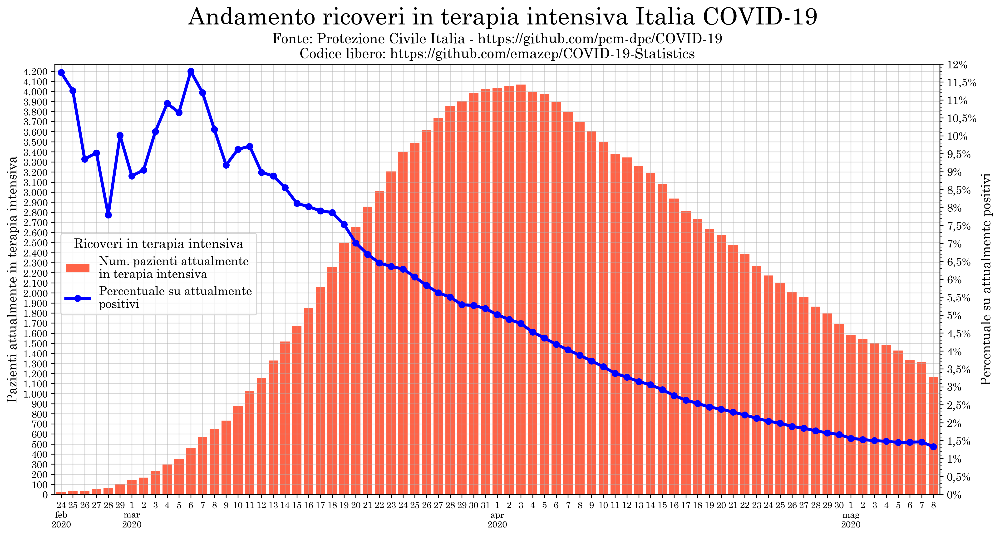

In [12]:
ALPHA = 0.5
SLACK = 0.54

# Tests trend
_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['terapia_intensiva'], label='Num. pazienti attualmente\nin terapia intensiva', color='tomato')

ax2 = ax.twinx()

ax2.plot(
    ds_it.index, ds_it['terapia_intensiva_RATIO'], label='Percentuale su attualmente\npositivi',
    **small_plt_params, marker='o', zorder=3, color='blue'
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))

ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=8)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Pazienti attualmente in terapia intensiva')
ax.tick_params(axis='y', which='both', labelsize=10)

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento ricoveri in terapia intensiva Italia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale su attualmente positivi')

ax2.set_ylim(bottom=0, top=0.12)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.005))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x*100:n}' + '%'))
ax2.tick_params(axis='y', which='both', labelsize=11)

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Ricoveri in terapia intensiva',
    fontsize=12, bbox_to_anchor=(0.235, 0.62)
)

fig_ICU = plt.gcf()

plt.show()

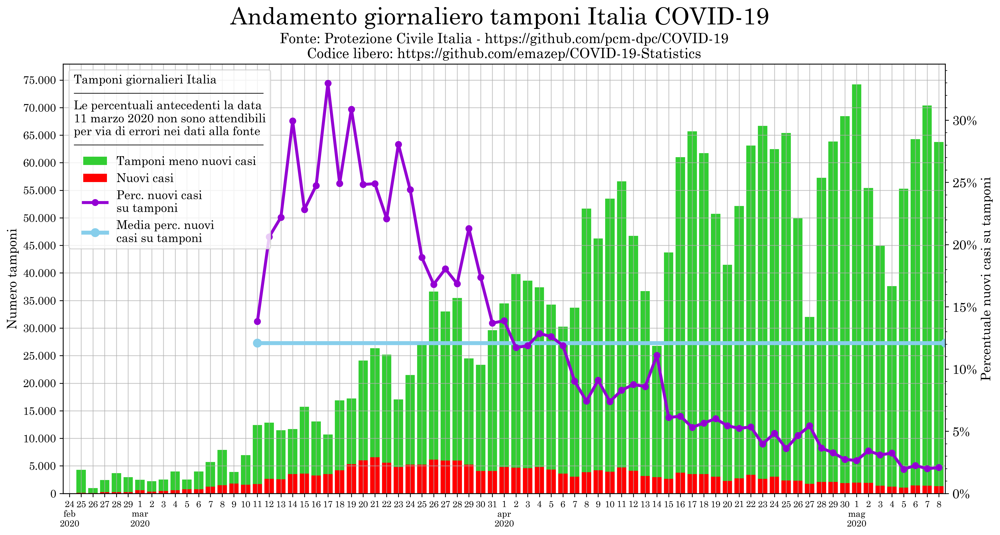

In [13]:
ALPHA = 0.7
SLACK = GLOBAL_SLACK

PERC_COLOR = 'darkviolet'
NEGATIVE_COLOR = 'limegreen'
POSITIVE_COLOR = 'red'

# Tests trend
_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['tamponi_negativi'], label='Tamponi meno nuovi casi', color=NEGATIVE_COLOR, bottom=ds_it['totale_casi_DELTA'])
ax.bar(ds_it.index, ds_it['totale_casi_DELTA'], label='Nuovi casi', color=POSITIVE_COLOR)

ax2 = ax.twinx()
ax2.plot(ds_it.index, ds_it['positive_test_RATIO'], label='Perc. nuovi casi\nsu tamponi', **small_plt_params, marker='o', zorder=3, color=PERC_COLOR)

ax2.axhline(
    y=ds_it['positive_test_RATIO'].mean(), zorder=0, label='Media perc. nuovi\ncasi su tamponi',
    color='skyblue', **common_plt_params, marker='o', alpha=1,
    xmin=(17/ds_it.index.size)-TAMPONI_MEAN_SLACK
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))

ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5_000))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=11)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Numero tamponi')

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('   Andamento giornaliero tamponi Italia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale nuovi casi su tamponi')

ax2.set_ylim(bottom=0)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.05))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.01))
ax2.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1, decimals=0))

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

rcParams['font.size'] = 12

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Tamponi giornalieri Italia' + sep + '\nLe percentuali antecedenti la data\n11 marzo 2020 non sono attendibili\nper via di errori nei dati alla fonte' + sep,
    fontsize=12, loc='upper left'
)

fig_tests = plt.gcf()
plt.show()

rcParams['font.size'] = DEFAULT_FONT_SIZE

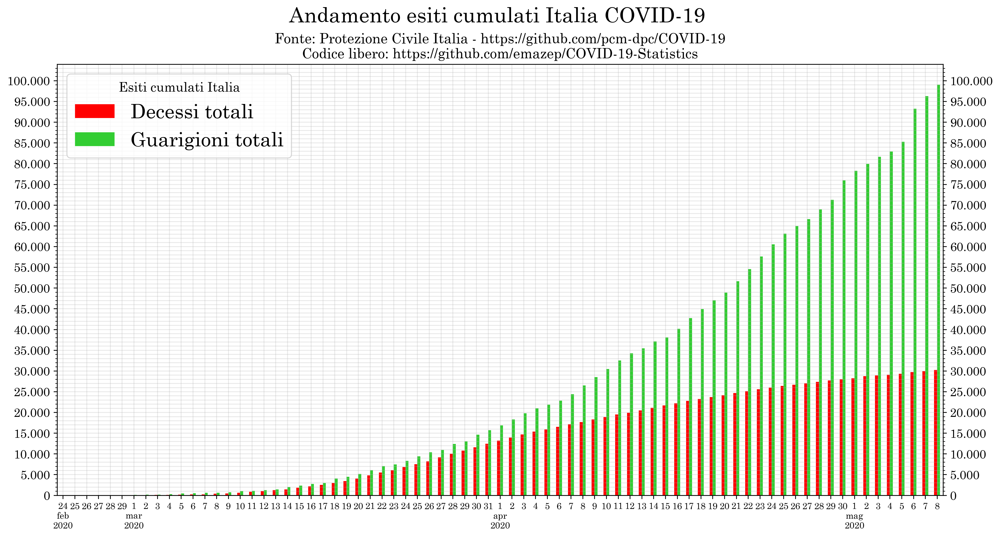

In [14]:
# Exitus trend
ALPHA = 0.3
BAR_WIDTH = 0.3

ax = ds_it.plot.bar(
    y=['deceduti', 'dimessi_guariti'], label=['Decessi totali', 'Guarigioni totali'],
    color=['r', 'limegreen'], figsize=(16,8)
)

ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates_from_numbers))
plt.xticks(rotation=0)
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)

ax.yaxis.set_major_locator(ticker.MultipleLocator(5_000))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(1_000))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title="Esiti cumulati Italia", fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento esiti cumulati Italia COVID-19', fontsize=21)

fig_exitus = plt.gcf()

plt.show()

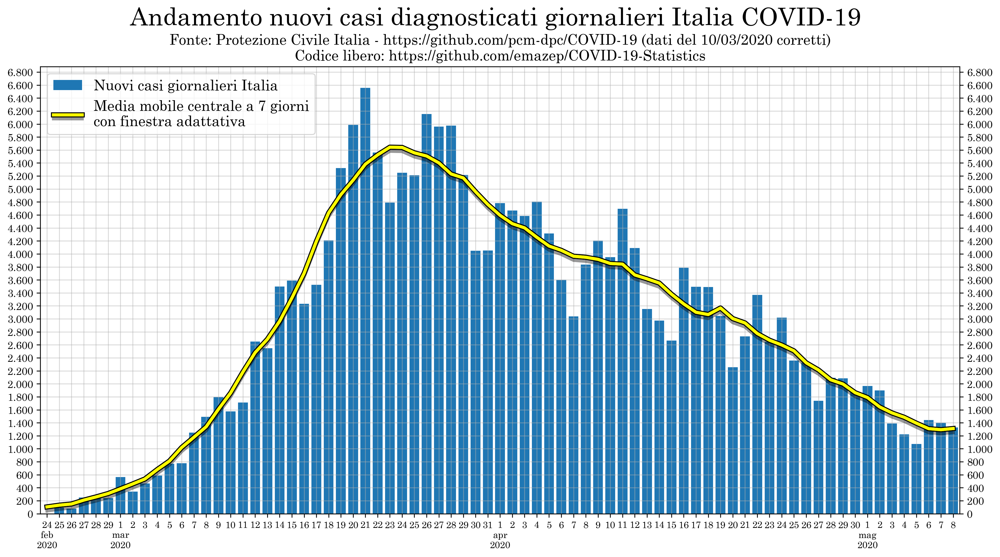

In [15]:
ALPHA = 0.5
LINE_COLOR = 'yellow'
BORDER_COLOR = 'black'
BAR_COLOR = 'tab:blue'
SLACK = GLOBAL_SLACK

_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['totale_casi_DELTA'], label='Nuovi casi giornalieri Italia', color=BAR_COLOR, zorder=1)
ax.plot(
    ds_it.index, ds_it['totale_casi_DELTA_RA_7'], label='Media mobile centrale a 7 giorni\ncon finestra adattativa',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))

ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)

ax.yaxis.set_major_locator(ticker.MultipleLocator(200))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=10)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))

ax.grid(which='major', alpha=ALPHA)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.set_title(SUBTITLE, fontsize=14)
plt.suptitle('   Andamento nuovi casi diagnosticati giornalieri Italia COVID-19', fontsize=24)

#handles, labels = ax.get_legend_handles_labels()
# sort both labels and handles by labels
#labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
#ax.legend(handles, labels, title="Tamponi giornalieri Italia", fontsize=24)

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), fontsize=14, loc='upper left')

fig_daily_incr = plt.gcf()

plt.show()

In [16]:
ds_reg = pd.read_csv('https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-regioni/dpc-covid19-ita-regioni.csv', parse_dates=['data'])
ds_reg['data'] = ds_reg['data'].dt.date
ds_reg.set_index('data', inplace=True)
ds_reg.tail(21)

,stato,codice_regione,denominazione_regione,lat,long,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,nuovi_positivi,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,note_it,note_en
data,,,,,,,,,,,,,,,,,,,
2020-05-08,ITA,13,Abruzzo,42.351222,13.398438,250,10,260,1453,1713,-57,6,1014,351,3078,46103,32619.0,NaN,NaN
2020-05-08,ITA,17,Basilicata,40.639471,15.805148,48,2,50,102,152,-3,-1,204,26,382,16777,16285.0,dc-IT-0024,dc-EN-0024
2020-05-08,ITA,4,P.A. Bolzano,46.499335,11.356624,78,9,87,415,502,-49,6,1767,289,2558,47908,21572.0,NaN,NaN
2020-05-08,ITA,18,Calabria,38.905976,16.594402,73,2,75,544,619,-14,1,417,90,1126,43980,41902.0,NaN,NaN
2020-05-08,ITA,15,Campania,40.839566,14.250850,418,28,446,1566,2012,-127,21,2164,386,4562,105399,51402.0,NaN,NaN
2020-05-08,ITA,8,Emilia-Romagna,44.494367,11.341721,1680,163,1843,5887,7730,-281,111,15071,3797,26598,221866,144009.0,NaN,NaN
2020-05-08,ITA,6,Friuli Venezia Giulia,45.649435,13.768136,105,2,107,804,911,-16,9,1897,308,3116,82902,52784.0,NaN,NaN
2020-05-08,ITA,12,Lazio,41.892770,12.483667,1278,84,1362,2966,4328,-20,52,2209,549,7086,169499,133674.0,NaN,NaN
2020-05-08,ITA,7,Liguria,44.411493,8.932699,517,46,563,2613,3176,-72,78,4282,1265,8723,63531,39145.0,NaN,NaN


In [17]:
# Columns mapping to avoid column names clashing when merging different regions/province 
def new_columns_mapping(ds, unit_name):
    new_column_names = {}
    for column_name in ds.columns:
        new_column_names[column_name] = column_name + '_' + unit_name
    return new_column_names

In [56]:
### REGIONAL DATA RESHAPING ###

# Except Lombardia
ITALIAN_REGIONS = [
    'Abruzzo', 'Basilicata', 'Calabria', 'Campania', 'Emilia-Romagna', 'Friuli Venezia Giulia', 'Lazio', 'Liguria', 'Marche', 'Molise',
    'P.A. Bolzano', 'P.A. Trento', 'Piemonte', 'Sardegna', 'Sicilia', 'Puglia', 'Toscana', 'Umbria', "Valle d'Aosta", 'Veneto'
]
INTERESTING_FIELDS = [
    'totale_casi', 'tamponi', 'casi_testati', 'dimessi_guariti', 'deceduti', 'totale_positivi',
    'variazione_totale_positivi', 'nuovi_positivi', 'terapia_intensiva',
    'ricoverati_con_sintomi', 'totale_ospedalizzati', 'isolamento_domiciliare'
]
    
# Only Lombardia processed here
ds_Lombardia = ds_reg.loc[ds_reg['denominazione_regione'] == 'Lombardia'].loc[:,INTERESTING_FIELDS].copy()
# Corrections first
fix_2020_03_10(ds_Lombardia, region=True)
# Then
add_delta_growth_perc(ds_Lombardia)
add_ra(ds_Lombardia)
# Lastly
ds_Lombardia.rename(columns=new_columns_mapping(ds_Lombardia, 'Lombardia'), inplace=True)

# Build a new ds for each region (except Lombardia) as a dict value keyed by its corresponding region name
region_dss = {'Lombardia': ds_Lombardia}
for region_str in ITALIAN_REGIONS:
    region_dss[region_str] = ds_reg.loc[ds_reg['denominazione_regione'] == region_str].loc[:,INTERESTING_FIELDS].copy()

# Init region sided ds
ds_regions_sided = ds_Lombardia

# Exclude the already processed Lombardia from this second loop!
for region_str in ITALIAN_REGIONS:
    region_ds = region_dss[region_str]
    # First add calculated columns
    add_delta_growth_perc(region_ds)
    add_ra(region_ds)
    # Then rename the otherwise conflicting columns
    region_ds.rename(columns=new_columns_mapping(region_ds, region_str), inplace=True)
    # Lastly merge the ds
    ds_regions_sided = pd.merge(left=ds_regions_sided, right=region_ds, on='data').copy()

#ds_regions_sided
ds_regions_sided.loc[:, [
    'tamponi_DELTA_Lombardia', 'totale_positivi_Lombardia', 'casi_testati_DELTA_Lombardia', 'nuovi_positivi_Lombardia', 'variazione_totale_positivi_Lombardia', 'deceduti_Lombardia', 'deceduti_DELTA_Lombardia',
    'totale_casi_DELTA_Molise', 'totale_casi_DELTA_Calabria', "totale_casi_DELTA_Valle d'Aosta", 'totale_casi_DELTA_Molise', 'totale_casi_DELTA_Sardegna',
]].tail(10)

,tamponi_DELTA_Lombardia,totale_positivi_Lombardia,casi_testati_DELTA_Lombardia,nuovi_positivi_Lombardia,variazione_totale_positivi_Lombardia,deceduti_Lombardia,deceduti_DELTA_Lombardia,totale_casi_DELTA_Molise,totale_casi_DELTA_Calabria,totale_casi_DELTA_Valle d'Aosta,totale_casi_DELTA_Molise,totale_casi_DELTA_Sardegna
data,,,,,,,,,,,,
2020-04-29,14472.0,36122,7426.0,786,378,13679,104.0,0.0,5.0,5.0,0.0,5.0
2020-04-30,11048.0,36211,5928.0,598,89,13772,93.0,1.0,6.0,4.0,1.0,5.0
2020-05-01,13701.0,36473,6942.0,737,262,13860,88.0,2.0,4.0,5.0,2.0,18.0
2020-05-02,13058.0,36667,6561.0,533,194,14189,329.0,1.0,0.0,3.0,1.0,2.0
2020-05-03,7155.0,36926,3793.0,526,259,14231,42.0,0.0,2.0,6.0,0.0,4.0
2020-05-04,7978.0,37307,4485.0,577,381,14294,63.0,0.0,4.0,1.0,0.0,-2.0
2020-05-05,6455.0,37092,3631.0,500,-215,14389,95.0,0.0,1.0,0.0,0.0,1.0
2020-05-06,14516.0,31753,7672.0,764,-5339,14611,222.0,3.0,3.0,3.0,3.0,1.0
2020-05-07,15488.0,32015,0.0,720,262,14745,134.0,1.0,3.0,4.0,1.0,5.0


In [19]:
def make_regions_group_w_ra(plot_columns, days=7):
    ds_regions_group = ds_regions_sided.loc[:,plot_columns].copy()
    ds_regions_group['mean'] = ds_regions_group.mean(axis=1)
    ds_regions_group['mean_RA'] = ds_regions_group['mean'].rolling(window=days, center=True, min_periods=math.ceil(days/2)).mean()
    return ds_regions_group

In [20]:
# Upon request of the column to plot, prepend the local unit (regione/provincia) to it.
def localize_plot_column(column, local_strs):
    return [column + '_' + local_str for local_str in local_strs]

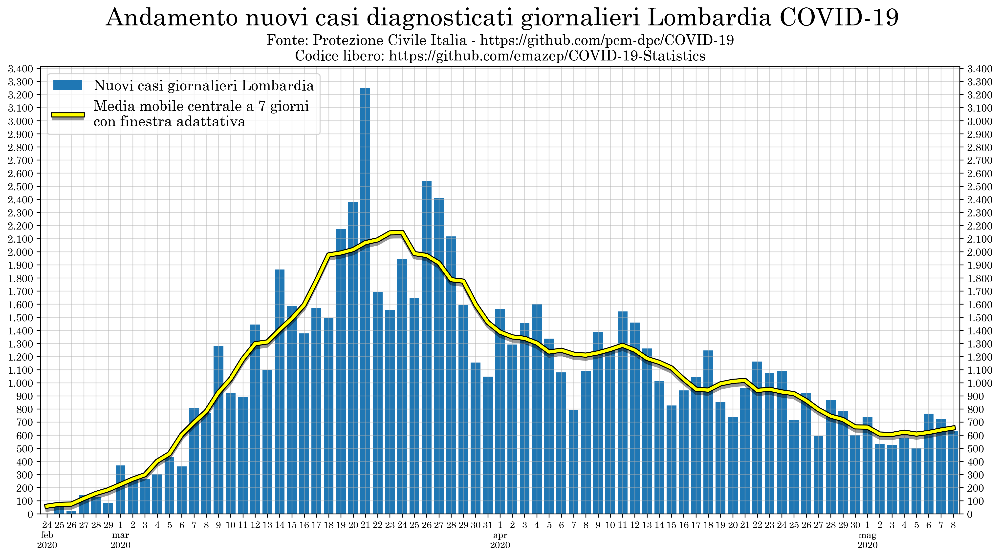

In [21]:
# Daily incr Lombardia

ALPHA = 0.5
LINE_COLOR = 'yellow'
BORDER_COLOR = 'black'
BAR_COLOR = 'tab:blue'
SLACK = GLOBAL_SLACK

REGIONS = ['Lombardia']

_, ax = plt.subplots(figsize=(16,8))

ax.bar(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column(
    'totale_casi_DELTA', REGIONS)[0]], label='Nuovi casi giornalieri Lombardia', color=BAR_COLOR, zorder=1
)
ax.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('totale_casi_DELTA_RA_7', REGIONS)[0]],
    label='Media mobile centrale a 7 giorni\ncon finestra adattativa', zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))

ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=10)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))

ax.grid(which='major', alpha=ALPHA)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('     Andamento nuovi casi diagnosticati giornalieri Lombardia COVID-19', fontsize=24)

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), loc='upper left', fontsize=14)

fig_daily_incr_regions_Lombardia = plt.gcf()

plt.show()

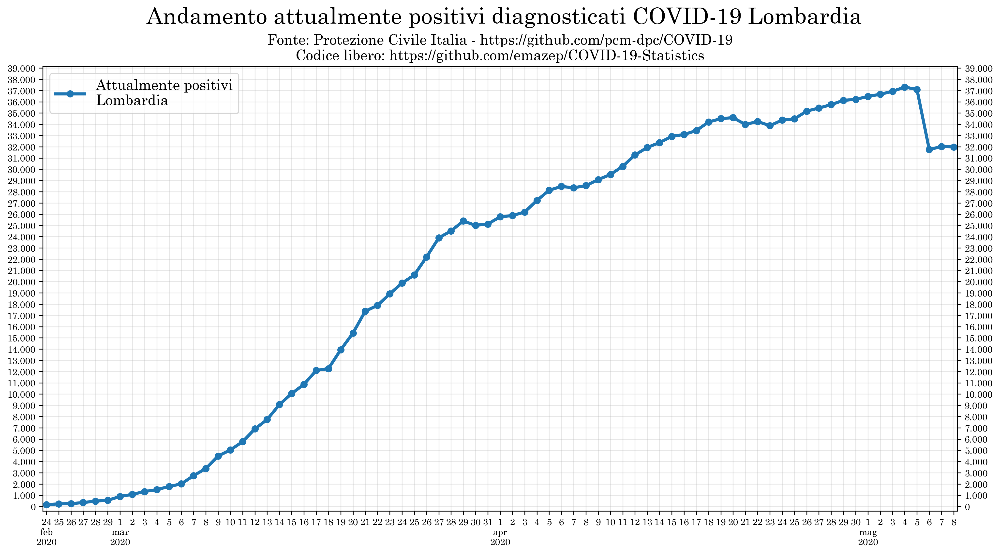

In [22]:
# Lombardia trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Lombardia']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
'''
ds_regions_group = make_regions_group_w_ra(plot_columns, days=3)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)
'''
ax = ds_regions_sided.plot(y=plot_columns, label=['Attualmente positivi\nLombardia'], figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(1_000))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=9)

ax.set_ylim(bottom=-400)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento attualmente positivi diagnosticati COVID-19 Lombardia', fontsize=22)

fig_cum_Lombardia = plt.gcf()

plt.show()

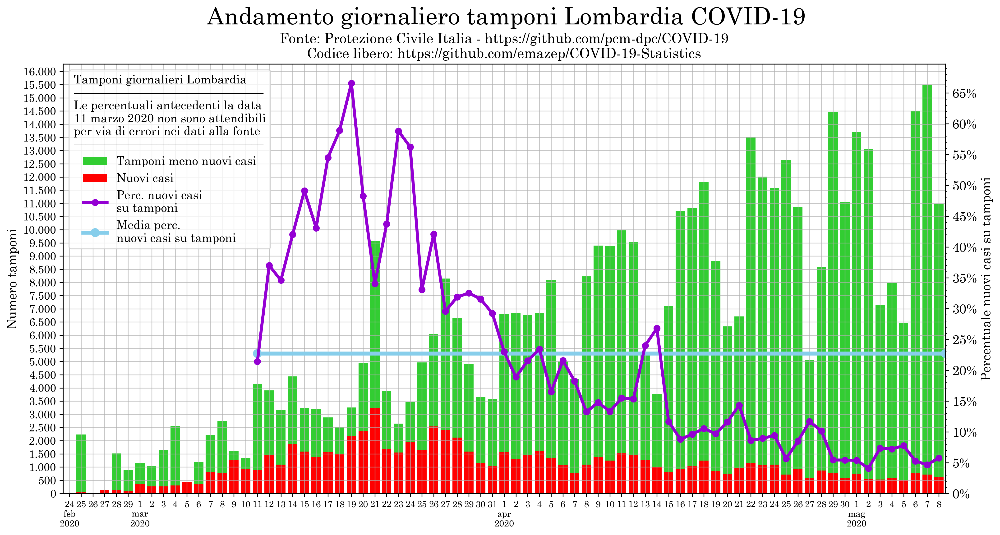

In [23]:
# TAMPONI LOMBARDIA

ALPHA = 0.7
SLACK = GLOBAL_SLACK

PERC_COLOR = 'darkviolet'
NEGATIVE_COLOR = 'limegreen'
POSITIVE_COLOR = 'red'

REGIONS = ['Lombardia']

# Tests trend
_, ax = plt.subplots(figsize=(16,8))

ax.bar(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('tamponi_negativi', REGIONS)[0]],
    label='Tamponi meno nuovi casi', color=NEGATIVE_COLOR, bottom=ds_regions_sided[localize_plot_column('totale_casi_DELTA', REGIONS)[0]]
)
ax.bar(ds_regions_sided.index, ds_regions_sided[localize_plot_column('totale_casi_DELTA', REGIONS)[0]], label='Nuovi casi', color=POSITIVE_COLOR)

ax2 = ax.twinx()
ax2.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('positive_test_RATIO', REGIONS)[0]],
    label='Perc. nuovi casi\nsu tamponi', **small_plt_params, marker='o', zorder=3, color=PERC_COLOR
)

ax2.axhline(
    y=ds_regions_sided[localize_plot_column('positive_test_RATIO', REGIONS)[0]].mean(),
    zorder=0, label='Media perc.\nnuovi casi su tamponi',
    color='skyblue', **common_plt_params, marker='o', alpha=1,
    xmin=(17/ds_it.index.size)-TAMPONI_MEAN_SLACK
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))

ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(500))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=11)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Numero tamponi')

ax.grid(which='major', alpha=ALPHA)

ax.set_ylim(bottom=0)
ax2.set_ylim(bottom=0)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('     Andamento giornaliero tamponi Lombardia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale nuovi casi su tamponi')

ax2.set_ylim(bottom=0)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.05))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.01))
ax2.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1, decimals=0))

rcParams['font.size'] = 12

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()
sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Tamponi giornalieri Lombardia' + sep + '\nLe percentuali antecedenti la data\n11 marzo 2020 non sono attendibili\nper via di errori nei dati alla fonte' + sep,
    fontsize=12, loc='upper left'
)

fig_tests_Lombardia = plt.gcf()
plt.show()

rcParams['font.size'] = DEFAULT_FONT_SIZE

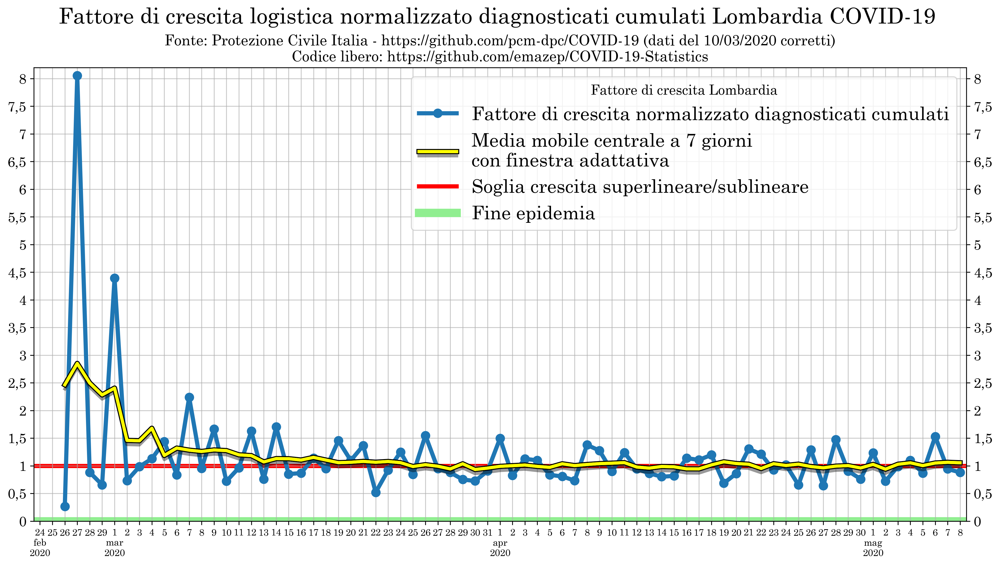

In [24]:
# Growth factor
SLACK = 0.5
ALPHA = 0.7

REGIONS = ['Lombardia']
single_column = localize_plot_column('tamponi_DELTA', REGIONS)[0]

ax = ds_regions_sided.plot(
    y=localize_plot_column('growth_factor_cum_infected', REGIONS)[0], label='Fattore di crescita normalizzato diagnosticati cumulati', **common_plt_params, marker='o', figsize=(16, 8), zorder=3
)
ax.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('growth_factor_cum_infected_RA_7', REGIONS)[0]],
    label='Media mobile centrale a 7 giorni\ncon finestra adattativa', zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)
plt.axhline(y=1, color='red', linewidth=4, zorder=0, alpha=1, label='Soglia crescita superlineare/sublineare')
plt.axhline(y=0, color='lightgreen', linewidth=8, zorder=0, alpha=1, label='Fine epidemia')

set_xlim(ax, SLACK)

ax.set_ylim(bottom=0)

#ax.xaxis.set_major_locator(mdates.AutoDateLocator())
ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(0.5))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylim(top=8.2)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

ax.legend(title="Fattore di crescita Lombardia", fontsize=18)

plt.xlabel(None)

ax.set_title(SUBTITLE, fontsize=14)
plt.suptitle('    Fattore di crescita logistica normalizzato diagnosticati cumulati Lombardia COVID-19', fontsize=21)

fig_growth_Lombardia = plt.gcf()

plt.show()

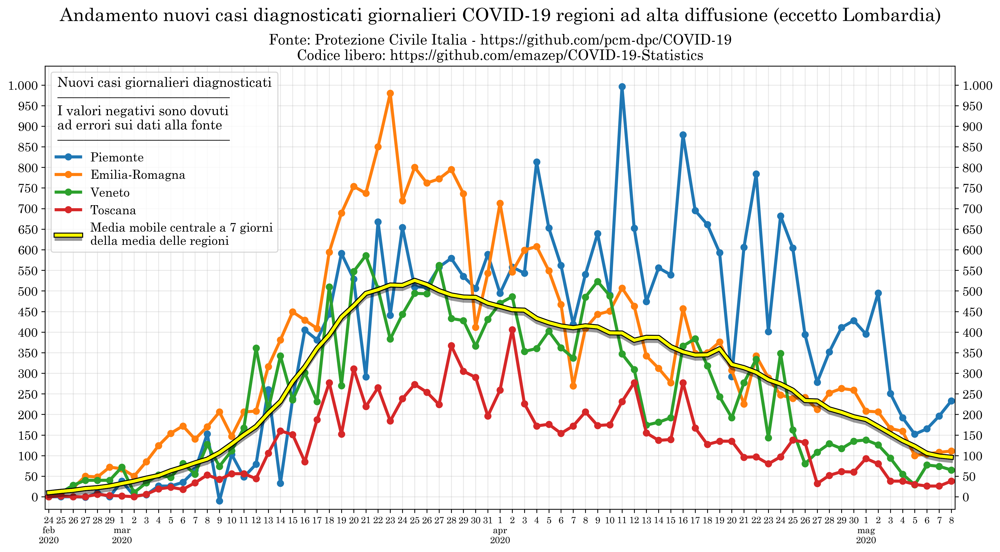

In [25]:
# Highly critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Piemonte', 'Emilia-Romagna', 'Veneto', 'Toscana']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-30)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni ad alta diffusione (eccetto Lombardia)', fontsize=18)

fig_daily_incr_regions_high = plt.gcf()

plt.show()

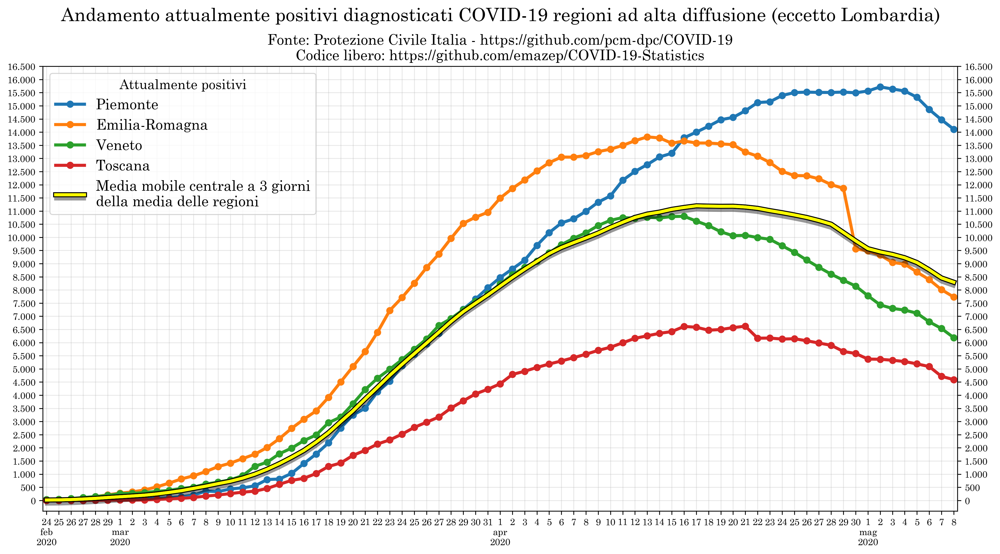

In [26]:
# Highly critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Piemonte', 'Emilia-Romagna', 'Veneto', 'Toscana']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(500))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=9)

ax.set_ylim(bottom=-400)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento attualmente positivi diagnosticati COVID-19 regioni ad alta diffusione (eccetto Lombardia)', fontsize=18)

fig_cum_regions_high = plt.gcf()

plt.show()

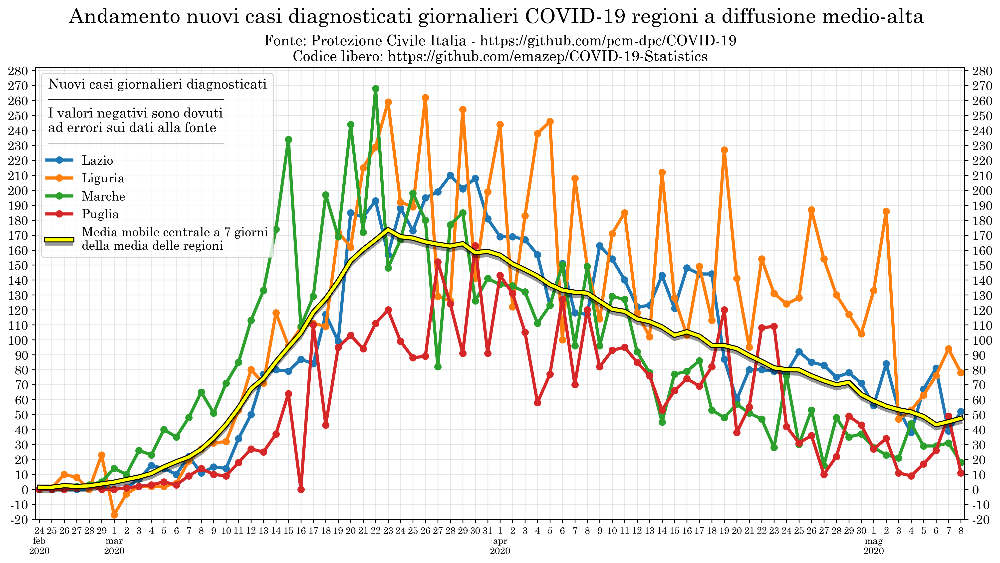

In [27]:
# Medium-high critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Lazio', 'Liguria', 'Marche', 'Puglia']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(10))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-20)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a diffusione medio-alta', fontsize=20)

fig_daily_incr_regions_medium_high = plt.gcf()

plt.show()

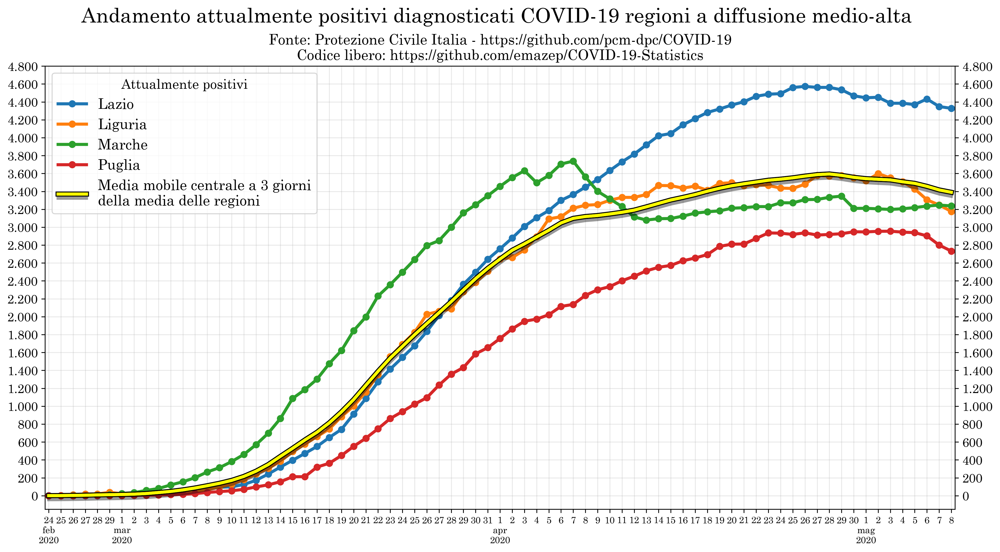

In [28]:
# Medium critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Lazio', 'Liguria', 'Marche', 'Puglia']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(200))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-150)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento attualmente positivi diagnosticati COVID-19 regioni a diffusione medio-alta', fontsize=20)

fig_cum_regions_medium_high = plt.gcf()

plt.show()

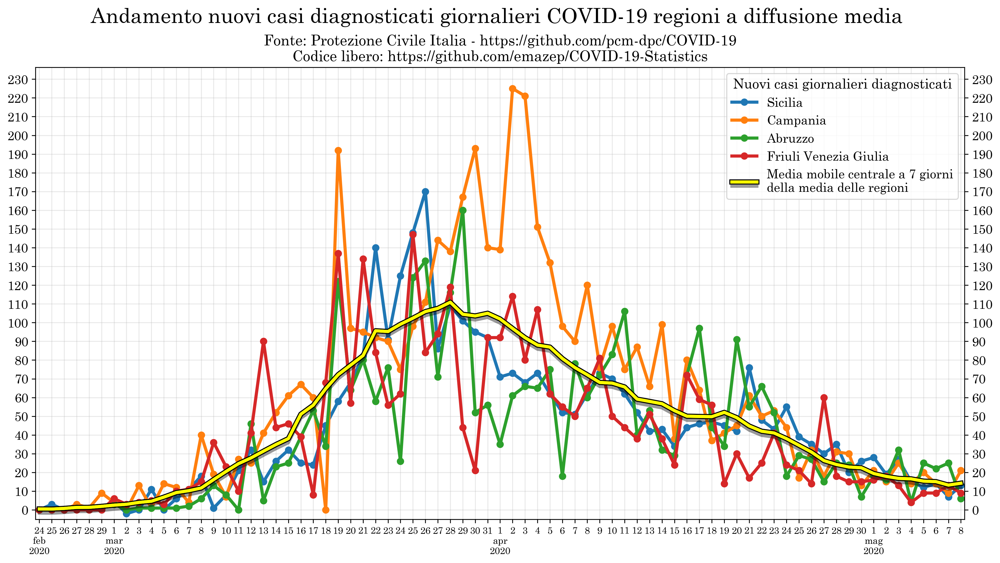

In [57]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Sicilia', 'Campania', 'Abruzzo', 'Friuli Venezia Giulia']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(10))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-5)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Nuovi casi giornalieri diagnosticati', fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a diffusione media', fontsize=20)

fig_daily_incr_regions_medium = plt.gcf()

plt.show()

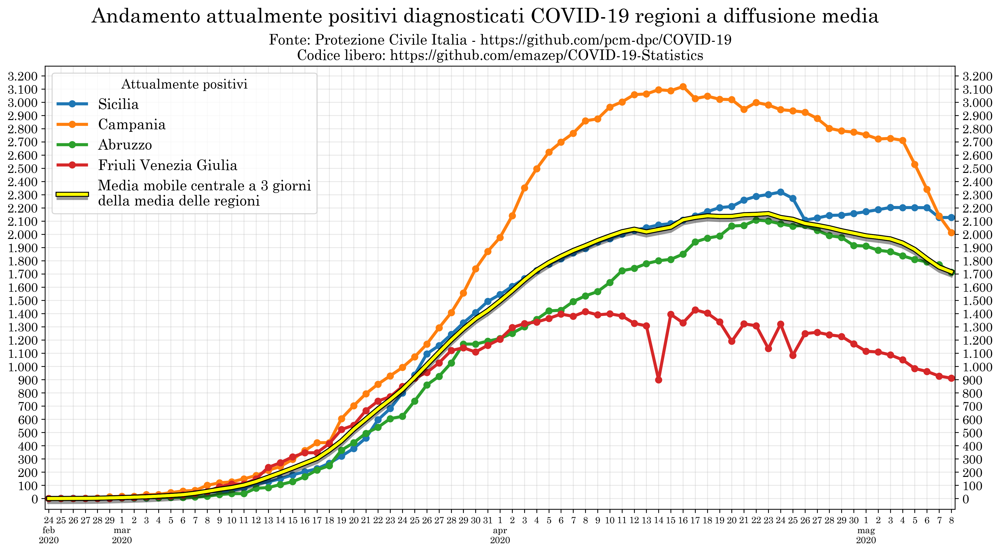

In [58]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Sicilia', 'Campania', 'Abruzzo', 'Friuli Venezia Giulia']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)
ax.set_ylim(bottom=-80)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('Andamento attualmente positivi diagnosticati COVID-19 regioni a diffusione media', fontsize=20)

fig_cum_regions_medium = plt.gcf()

plt.show()

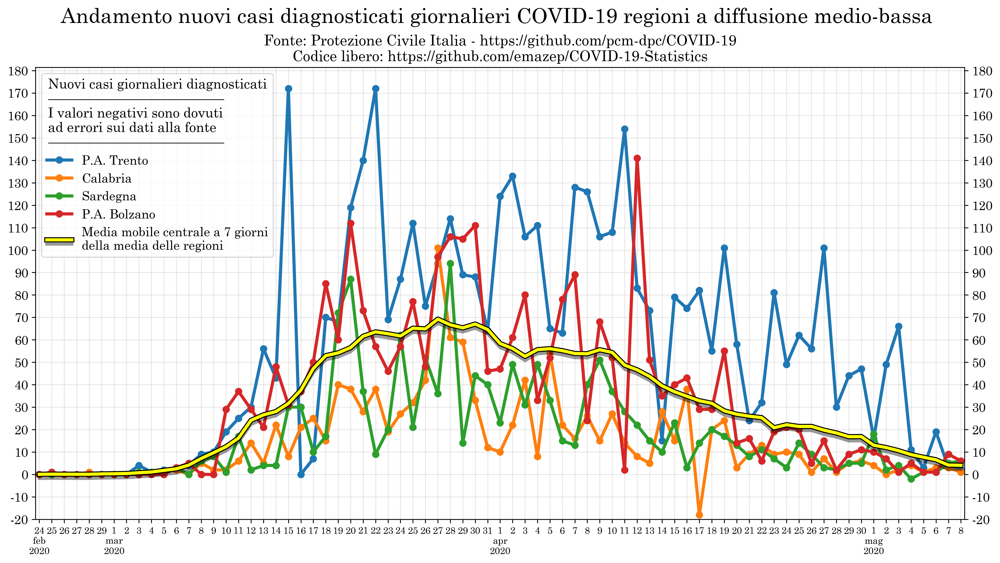

In [31]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['P.A. Trento', 'Calabria', 'Sardegna', 'P.A. Bolzano']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(10))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)
ax.set_ylim(bottom=-20)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a diffusione medio-bassa', fontsize=20)

fig_daily_incr_regions_medium_low = plt.gcf()

plt.show()

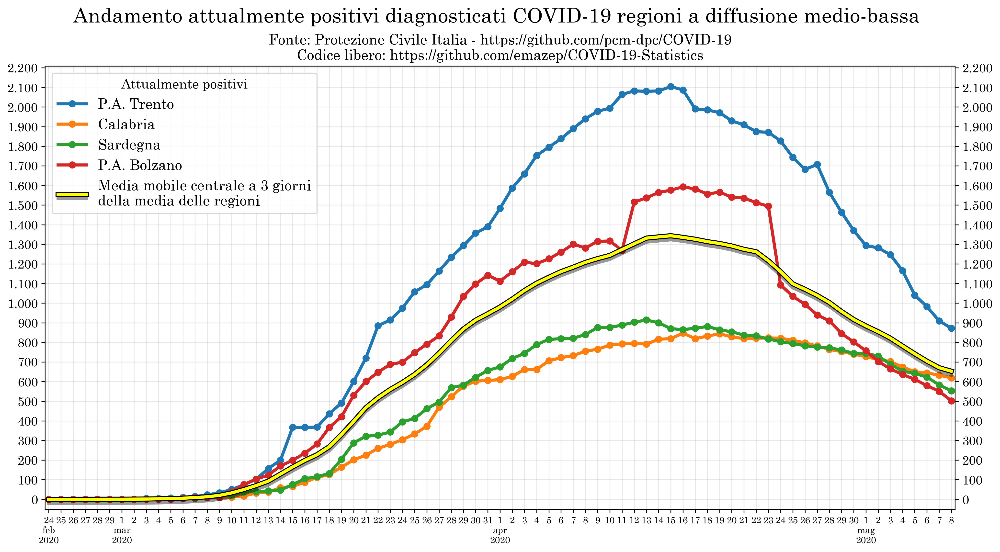

In [32]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['P.A. Trento', 'Calabria', 'Sardegna', 'P.A. Bolzano']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)
ax.set_ylim(bottom=-50)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento attualmente positivi diagnosticati COVID-19 regioni a diffusione medio-bassa', fontsize=20)

fig_cum_regions_medium_low = plt.gcf()

plt.show()

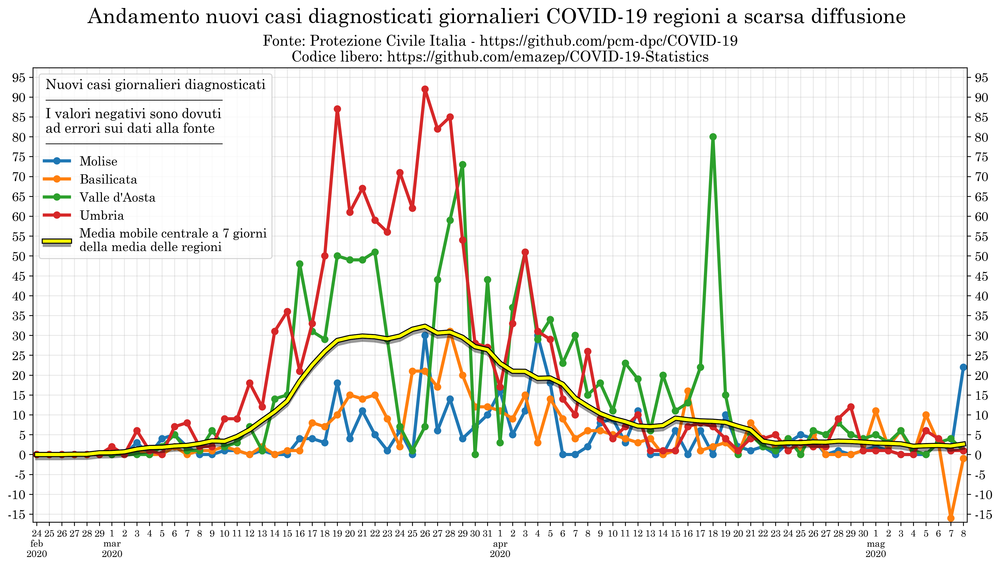

In [33]:
# Low critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Molise', 'Basilicata', "Valle d'Aosta", 'Umbria']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-17)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12, loc='upper left')

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a scarsa diffusione', fontsize=20)

fig_daily_incr_regions_low = plt.gcf()

plt.show()

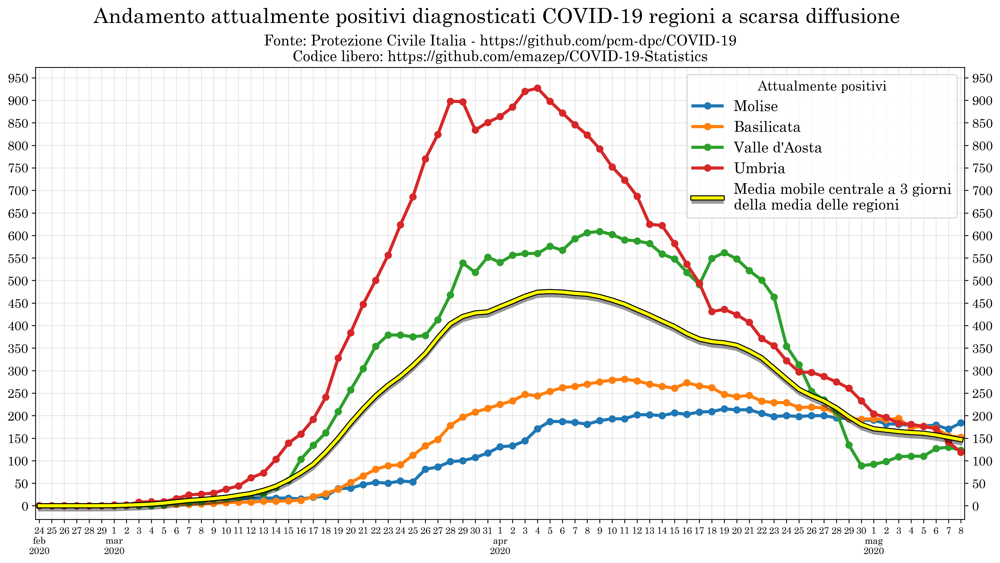

In [34]:
# Low critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Molise', 'Basilicata', "Valle d'Aosta", 'Umbria']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, color=LINE_COLOR, linewidth=3, path_effects=[pe_outline, pe_shadow, pe_normal]
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-30)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento attualmente positivi diagnosticati COVID-19 regioni a scarsa diffusione', fontsize=20)

fig_cum_regions_low = plt.gcf()

plt.show()

In [35]:
CONTAGIOUS_PERIOD = 23
last_day = ds_it.index.max()
#last_day = date.fromisoformat('2020-03-20')

last_day_2 = last_day - dt.timedelta(days=1)
last_day_3 = last_day - dt.timedelta(days=2)
last_day_4 = last_day - dt.timedelta(days=3)
last_day_7 = last_day - dt.timedelta(days=6)

last_day_11 = last_day - dt.timedelta(days=11)
last_day_9 = last_day - dt.timedelta(days=9)

# Nation-wide
# Tamponi
ds_it_last_3_days = ds_it.loc[last_day_3:, ['totale_casi_DELTA', 'tamponi_DELTA']].agg('sum')

# R0
ds_it_7_days_ago_mean = ds_it.loc[last_day_11:last_day_9, ['totale_positivi']].agg('mean')
ds_it_last_7_days_mean = ds_it.loc[last_day_7:, ['totale_casi_DELTA']].agg('mean')
R0_it = ds_it_last_7_days_mean['totale_casi_DELTA'] / ds_it_7_days_ago_mean['totale_positivi'] * CONTAGIOUS_PERIOD

R0_it

0.30466822794691645

In [36]:
# Regions

###

ds_reg_last_day = ds_reg[last_day:].copy()

ds_reg_last_day['CFR'] = ds_reg_last_day['deceduti'] / ds_reg_last_day['totale_casi']
ds_reg_last_day['pop'] = ds_reg_last_day['denominazione_regione'].map(REGIONS_POP)
ds_reg_last_day['infection_density'] = ds_reg_last_day['totale_positivi'] / ds_reg_last_day['pop'] * 1_000
ds_reg_last_day['tamponi_density'] = ds_reg_last_day['tamponi'] / ds_reg_last_day['pop']
ds_reg_last_day['death_density'] = ds_reg_last_day['deceduti'] / ds_reg_last_day['pop']
ds_reg_last_day['icu_density'] = ds_reg_last_day['terapia_intensiva'] / ds_reg_last_day['totale_positivi']
#ds_reg_last_day

# MAX DELTA PERC
ds_reg_last_day['totale_positivi_MAX'] = None
for region_name in ds_reg_last_day['denominazione_regione']:
    max_totale_positivi_value = ds_reg.loc[ds_reg['denominazione_regione']==region_name, ['totale_positivi']].max().values
    ds_reg_last_day.loc[ds_reg_last_day['denominazione_regione']==region_name, 'totale_positivi_MAX'] = max_totale_positivi_value

ds_reg_last_day['totale_positivi_MAX_DELTA_PERC'] = (ds_reg_last_day['totale_positivi_MAX'] - ds_reg_last_day['totale_positivi']) / ds_reg_last_day['totale_positivi_MAX']

###

ds_reg_last_3_days = ds_reg[last_day_3:].groupby('denominazione_regione').agg(
    nuovi_positivi = pd.NamedAgg(column='nuovi_positivi', aggfunc='sum'),
    tamponi = pd.NamedAgg(column='tamponi', aggfunc='max')
)

# Tamponi
ds_reg_4_days_ago = ds_reg.loc[last_day_4, ['denominazione_regione', 'tamponi']].groupby('denominazione_regione').agg(tamponi = pd.NamedAgg(column='tamponi', aggfunc='max'))
ds_reg_last_3_days['tamponi'] -= ds_reg_4_days_ago['tamponi']
ds_reg_last_3_days['test_RATIO'] = ds_reg_last_3_days['nuovi_positivi'] / ds_reg_last_3_days['tamponi']
# Needed for the graph
ds_reg_last_3_days['denominazione_regione'] = ds_reg_last_3_days.index

# R0
ds_reg_R0 = ds_reg[last_day_11:last_day_9].groupby('denominazione_regione').agg(
    totale_positivi = pd.NamedAgg(column='totale_positivi', aggfunc='mean')
)
ds_reg_last_7_days = ds_reg[last_day_7:].groupby('denominazione_regione').agg(
    nuovi_positivi_mean = pd.NamedAgg(column='nuovi_positivi', aggfunc='mean')
)
ds_reg_R0['R0'] = ds_reg_last_7_days['nuovi_positivi_mean'] / ds_reg_R0['totale_positivi'] * CONTAGIOUS_PERIOD
ds_reg_R0['denominazione_regione'] = ds_reg_R0.index

ds_reg_R0

# Scatter
ds_reg_last_day.sort_values(by='totale_positivi_MAX_DELTA_PERC')


,stato,codice_regione,denominazione_regione,lat,long,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,...,note_it,note_en,CFR,pop,infection_density,tamponi_density,death_density,icu_density,totale_positivi_MAX,totale_positivi_MAX_DELTA_PERC
data,,,,,,,,,,,,,,,,,,,,,
2020-05-08,ITA,12,Lazio,41.892770,12.483667,1278,84,1362,2966,4328,...,NaN,NaN,0.077477,5879082,0.736169,0.028831,0.000093,0.019409,4573,0.0535753
2020-05-08,ITA,16,Puglia,41.125596,16.867367,349,33,382,2351,2733,...,NaN,NaN,0.104088,4029053,0.678323,0.018546,0.000110,0.012075,2955,0.0751269
2020-05-08,ITA,19,Sicilia,38.115697,13.362357,310,19,329,1798,2127,...,NaN,NaN,0.076643,4999891,0.425409,0.019743,0.000051,0.008933,2320,0.0831897
2020-05-08,ITA,1,Piemonte,45.073274,7.680687,2013,140,2153,11954,14107,...,NaN,NaN,0.116505,4356406,3.238220,0.046181,0.000759,0.009924,15719,0.102551
2020-05-08,ITA,7,Liguria,44.411493,8.932699,517,46,563,2613,3176,...,NaN,NaN,0.145019,1550640,2.048187,0.040971,0.000816,0.014484,3598,0.117287
2020-05-08,ITA,11,Marche,43.616760,13.518875,303,38,341,2897,3238,...,NaN,NaN,0.147450,1525271,2.122901,0.047535,0.000625,0.011736,3738,0.133761
2020-05-08,ITA,3,Lombardia,45.466794,9.190347,5702,400,6102,25881,31983,...,NaN,NaN,0.183826,10060574,3.179043,0.046348,0.001475,0.012507,37307,0.142708
2020-05-08,ITA,14,Molise,41.557748,14.659161,6,0,6,178,184,...,NaN,NaN,0.067278,305617,0.602061,0.027819,0.000072,0.000000,215,0.144186
2020-05-08,ITA,13,Abruzzo,42.351222,13.398438,250,10,260,1453,1713,...,NaN,NaN,0.114035,1311580,1.306058,0.035151,0.000268,0.005838,2108,0.187381


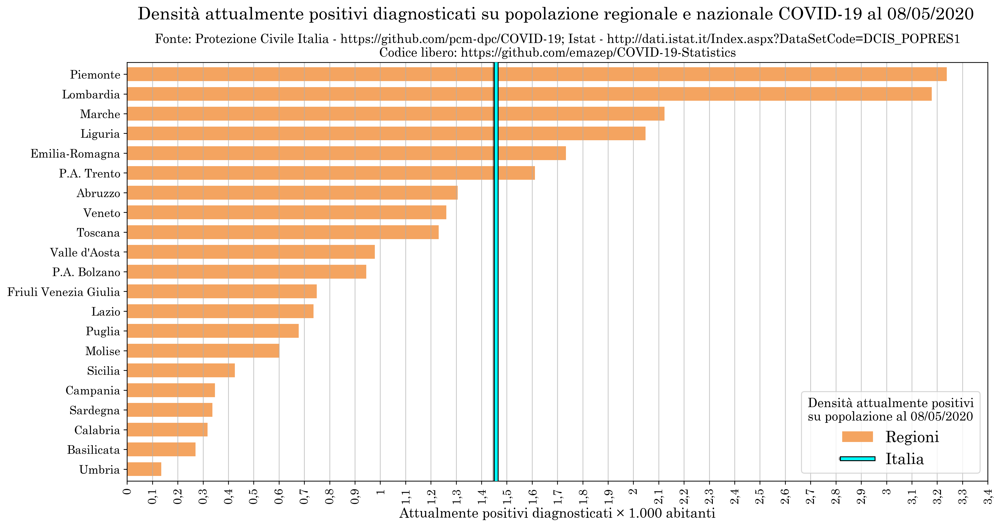

In [37]:
# Infected over pop
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_last_day_sorted = ds_reg_last_day.sort_values(by='infection_density')

x='denominazione_regione'
y='infection_density'

ax = ds_reg_last_day_sorted.plot.barh(
    x, y, figsize=(16,8), color='sandybrown', label='Regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.1))
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='x', which='both', labelsize=12)
plt.xticks(rotation=90)
ax.xaxis.grid(which='both', alpha=ALPHA)
plt.xlabel('Attualmente positivi diagnosticati × 1.000 abitanti', fontsize=14)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

last_index = ds_it.index.max()
infection_density_Italy = ds_it.loc[last_index, 'totale_positivi'] / 60_359_546 * 1_000
plt.axvline(x=infection_density_Italy, zorder=3, color='cyan', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='Italia')

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Densità attualmente positivi\nsu popolazione al '+last_date_str, fontsize=16)

ax.set_title(SUBTITLE_NO_CORR_ISTAT, fontsize=13)
plt.suptitle('     Densità attualmente positivi diagnosticati su popolazione regionale e nazionale COVID-19 al '+last_date_str, fontsize=18)

fig_density = plt.gcf()

plt.show()

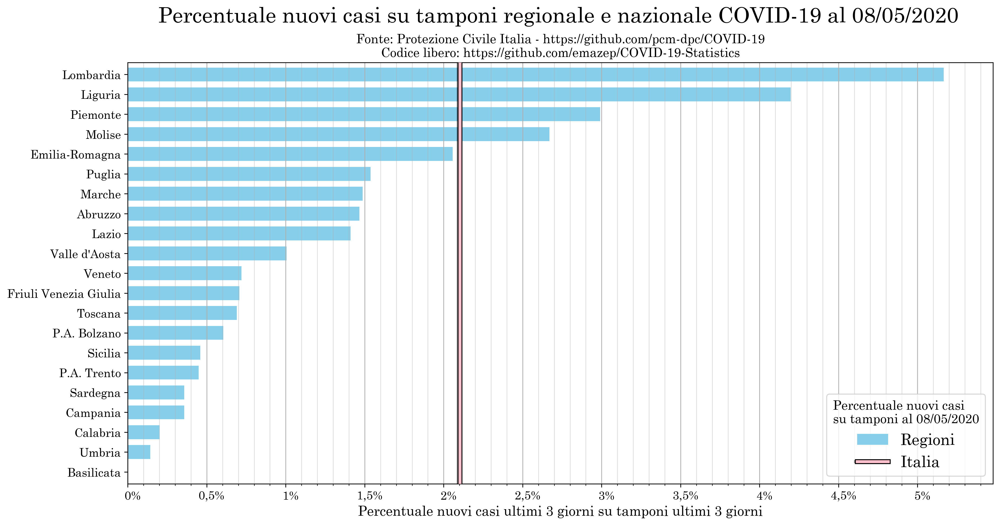

In [38]:
# Test RATIO
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_last_3_days_sorted = ds_reg_last_3_days.sort_values(by='test_RATIO')

x='denominazione_regione'
y='test_RATIO'

ax = ds_reg_last_3_days_sorted.plot.barh(
    x, y, figsize=(16,8), color='skyblue', label='Regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.005))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'   {x*100:n}'+'%'))
ax.tick_params(axis='x', which='both', labelsize=12)
#plt.xticks(rotation=90)
ax.xaxis.grid(which='major', alpha=1)
ax.xaxis.grid(which='minor', alpha=0.4)
plt.xlabel('Percentuale nuovi casi ultimi 3 giorni su tamponi ultimi 3 giorni', fontsize=14)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

ax.set_xlim(left=0)

last_index = ds_it.index.max()
perc_Italy =  ds_it_last_3_days['totale_casi_DELTA'] / ds_it_last_3_days['tamponi_DELTA']
plt.axvline(x=perc_Italy, zorder=3, color='pink', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='Italia')

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Percentuale nuovi casi\nsu tamponi al '+last_date_str, fontsize=16)

ax.set_title(SUBTITLE_NO_CORR, fontsize=13)
plt.suptitle('    Percentuale nuovi casi su tamponi regionale e nazionale COVID-19 al '+last_date_str, fontsize=22)

fig_regional_test_RATIO = plt.gcf()

plt.show()

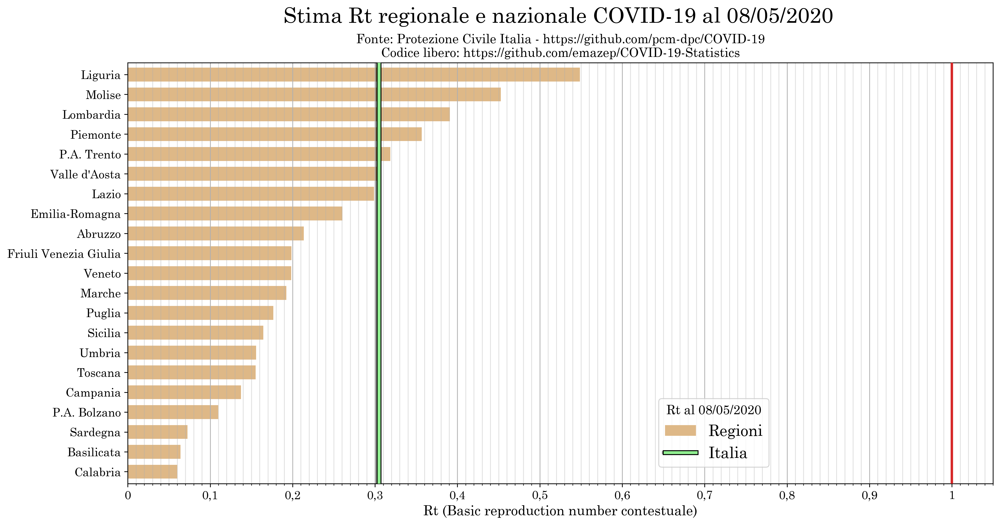

In [39]:
# R₀
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_R0_sorted = ds_reg_R0.sort_values(by='R0')

x='denominazione_regione'
y='R0'

ax = ds_reg_R0_sorted.plot.barh(
    x, y, figsize=(16,8), color='burlywood', label='Regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.1))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.01))
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='x', which='both', labelsize=12)
#plt.xticks(rotation=90)
ax.xaxis.grid(which='major', alpha=1)
ax.xaxis.grid(which='minor', alpha=0.4)
plt.xlabel('Rt (Basic reproduction number contestuale)', fontsize=14)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

last_index = ds_it.index.max()
plt.axvline(x=R0_it, zorder=3, color='lightgreen', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='Italia')
plt.axvline(x=1, zorder=3, color='tab:red', linewidth=2.5)

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Rt al '+last_date_str, fontsize=16, bbox_to_anchor=(0.75, 0.22))

ax.set_title(SUBTITLE_NO_CORR, fontsize=13)
plt.suptitle('    Stima Rt regionale e nazionale COVID-19 al '+last_date_str, fontsize=22)

fig_R0 = plt.gcf()

plt.show()

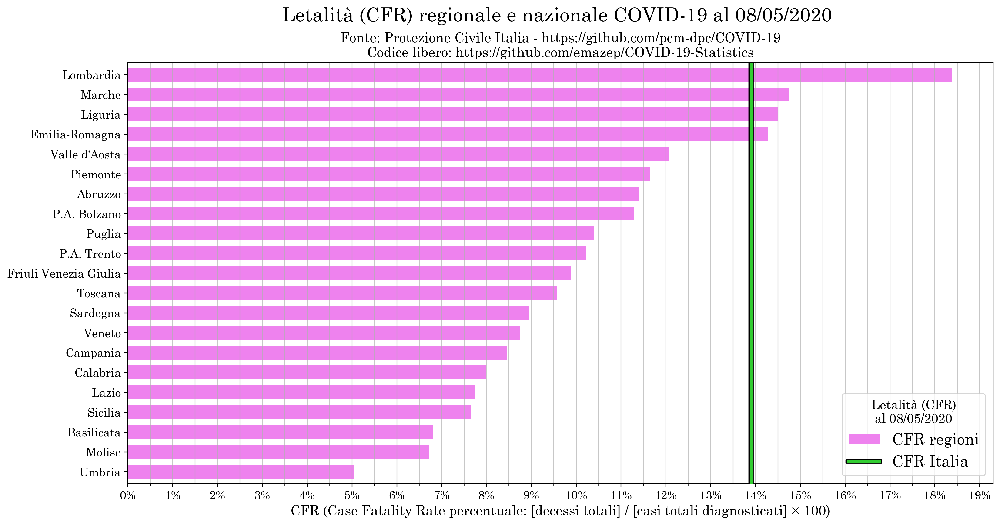

In [40]:
# CFR
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_last_day_sorted = ds_reg_last_day.sort_values(by='CFR')

x='denominazione_regione'
y='CFR'

ax = ds_reg_last_day_sorted.plot.barh(
    x, y, figsize=(16,8), color='violet', label='CFR regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.01))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.005))
ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1, decimals=0))
ax.tick_params(axis='x', which='both', labelsize=12)
ax.xaxis.grid(which='both', alpha=ALPHA)
plt.xlabel('CFR (Case Fatality Rate percentuale: [decessi totali] / [casi totali diagnosticati] × 100)', fontsize=14)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

last_index = ds_it.index.max()
CFR_Italy = ds_it.loc[last_index, 'deceduti'] / ds_it.loc[last_index, 'totale_casi']
plt.axvline(x=CFR_Italy, zorder=3, color='limegreen', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='CFR Italia')

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Letalità (CFR)\n al '+last_date_str, fontsize=16)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Letalità (CFR) regionale e nazionale COVID-19 al '+last_date_str, fontsize=20)

fig_CFR = plt.gcf()

plt.show()

In [41]:
ds_prov = pd.read_csv('https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-province/dpc-covid19-ita-province.csv', parse_dates=['data'])
#ds_prov = pd.read_csv('C:/Users/emazep/Downloads/dpc-covid19-ita-province.csv', parse_dates=['data'])
#ds_prov = pd.read_csv('dpc-covid19-ita-province.csv', parse_dates=['data'])
ds_prov['data'] = ds_prov['data'].dt.date
ds_prov.set_index('data', inplace=True)
ds_prov.loc[ds_prov['denominazione_provincia'] == 'Alessandria']

,stato,codice_regione,denominazione_regione,codice_provincia,denominazione_provincia,sigla_provincia,lat,long,totale_casi,note_it,note_en
data,,,,,,,,,,,
2020-02-24,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN,NaN
2020-02-25,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN,NaN
2020-02-26,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN,NaN
2020-02-27,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN,NaN
2020-02-28,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2020-05-04,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,3593,NaN,NaN
2020-05-05,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,3606,NaN,NaN
2020-05-06,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,3622,NaN,NaN


In [42]:
### PROVINCE DATA RESHAPING ###

# Except Lombardia
PROVINCE = ['Bergamo', 'Brescia', 'Cremona', 'Lodi', 'Milano', 'Pavia', 'Piacenza', 'Torino', 'Alessandria']
INTERESTING_FIELDS = ['totale_casi']

# Build a new ds for each region (except Lombardia) as a dict value keyed by its corresponding region name
province_dss = {}
for provincia_str in PROVINCE:
    province_dss[provincia_str] = ds_prov.loc[ds_prov['denominazione_provincia'] == provincia_str].loc[:,INTERESTING_FIELDS].copy()

ds_province_sided = None
first_iteration = True
for provincia_str in PROVINCE:
    provincia_ds = province_dss[provincia_str]
    # First add calculated columns
    provincia_ds['totale_casi_DELTA'] = provincia_ds['totale_casi'].diff()
    # Then rename the otherwise conflicting columns
    provincia_ds.rename(columns=new_columns_mapping(provincia_ds, provincia_str), inplace=True)
    # Lastly merge the ds
    if first_iteration:
        ds_province_sided = provincia_ds
        first_iteration = False
    else:
        ds_province_sided = pd.merge(left=ds_province_sided, right=provincia_ds, on='data').copy()

ds_province_sided.tail(10)

,totale_casi_Bergamo,totale_casi_DELTA_Bergamo,totale_casi_Brescia,totale_casi_DELTA_Brescia,totale_casi_Cremona,totale_casi_DELTA_Cremona,totale_casi_Lodi,totale_casi_DELTA_Lodi,totale_casi_Milano,totale_casi_DELTA_Milano,totale_casi_Pavia,totale_casi_DELTA_Pavia,totale_casi_Piacenza,totale_casi_DELTA_Piacenza,totale_casi_Torino,totale_casi_DELTA_Torino,totale_casi_Alessandria,totale_casi_DELTA_Alessandria
data,,,,,,,,,,,,,,,,,,
2020-04-29,11291,95.0,12806,115.0,6023,30.0,2959,12.0,19121,284.0,4280,52.0,3993,75.0,12839,275.0,3346,28.0
2020-04-30,11313,22.0,12861,55.0,6037,14.0,2966,7.0,19337,216.0,4349,69.0,4062,69.0,13098,259.0,3417,71.0
2020-05-01,11360,47.0,12929,68.0,6068,31.0,2994,28.0,19701,364.0,4416,67.0,4115,53.0,13311,213.0,3491,74.0
2020-05-02,11394,34.0,12999,70.0,6088,20.0,3017,23.0,19950,249.0,4456,40.0,4175,60.0,13603,292.0,3559,68.0
2020-05-03,11453,59.0,13028,29.0,6106,18.0,3047,30.0,20068,118.0,4490,34.0,4214,39.0,13794,191.0,3584,25.0
2020-05-04,11538,85.0,13122,94.0,6109,3.0,3062,15.0,20254,186.0,4522,32.0,4251,37.0,13916,122.0,3593,9.0
2020-05-05,11550,12.0,13168,46.0,6130,21.0,3114,52.0,20398,144.0,4551,29.0,4286,35.0,14018,102.0,3606,13.0
2020-05-06,11587,37.0,13267,99.0,6151,21.0,3155,41.0,20711,313.0,4621,70.0,4295,9.0,14116,98.0,3622,16.0
2020-05-07,11622,35.0,13391,124.0,6178,27.0,3204,49.0,20893,182.0,4652,31.0,4300,5.0,14204,88.0,3654,32.0


In [43]:
def make_province_group_w_ra(plot_columns, days=7):
    ds_province_group = ds_province_sided.loc[:,plot_columns].copy()
    ds_province_group['mean'] = ds_province_group.mean(axis=1)
    ds_province_group['mean_RA'] = ds_province_group['mean'].rolling(window=days).mean()
    return ds_province_group

In [44]:
BAR_WIDTH = 0.75

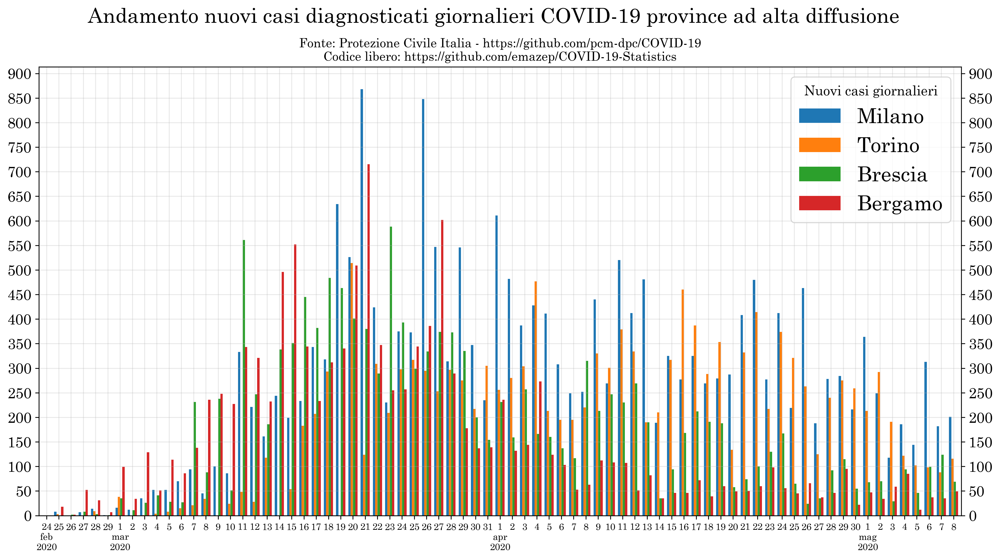

In [45]:
# Critical province trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Milano', 'Torino', 'Brescia', 'Bergamo']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ds_province_group = make_province_group_w_ra(plot_columns, days=7)

ax = ds_province_group.plot.bar(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=1, width=BAR_WIDTH)
#color=['r', 'limegreen', 'mediumblue']

ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates_from_numbers))
plt.xticks(rotation=0)
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=14)
ax.set_ylim(bottom=0)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Nuovi casi giornalieri', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=12)
plt.suptitle('   Andamento nuovi casi diagnosticati giornalieri COVID-19 province ad alta diffusione', fontsize=20)

fig_daily_incr_province_high = plt.gcf()

plt.show()

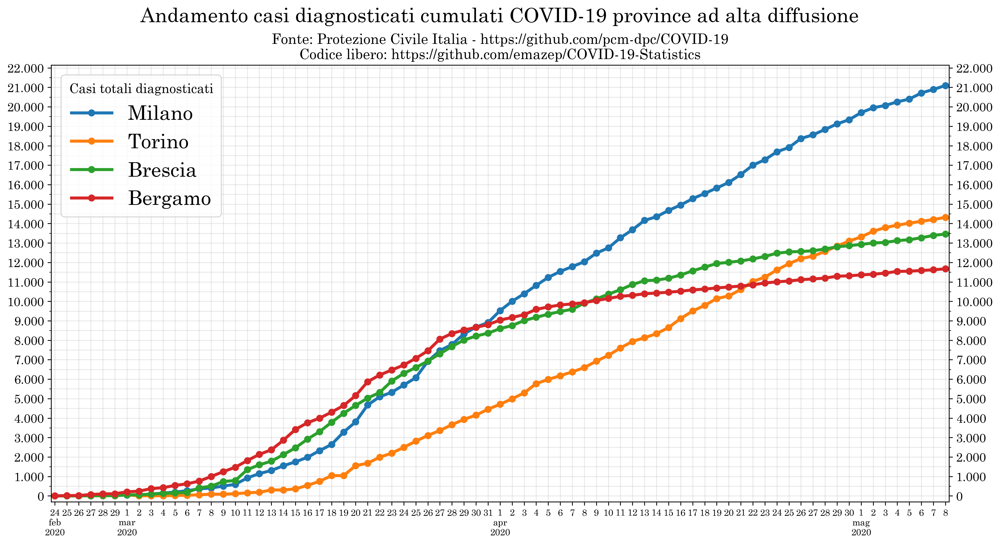

In [46]:
# High province cumulated trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Milano', 'Torino', 'Brescia', 'Bergamo']
COLUMN = 'totale_casi'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ax = ds_province_sided.plot(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(1000))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(500))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-300)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

#handles, labels = ax.get_legend_handles_labels()
#ax.legend(reversed(handles), reversed(labels), title='Casi totali diagnosticati', fontsize=24)
ax.legend(title='Casi totali diagnosticati', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('     Andamento casi diagnosticati cumulati COVID-19 province ad alta diffusione', fontsize=20)

fig_cum_province_high = plt.gcf()

plt.show()

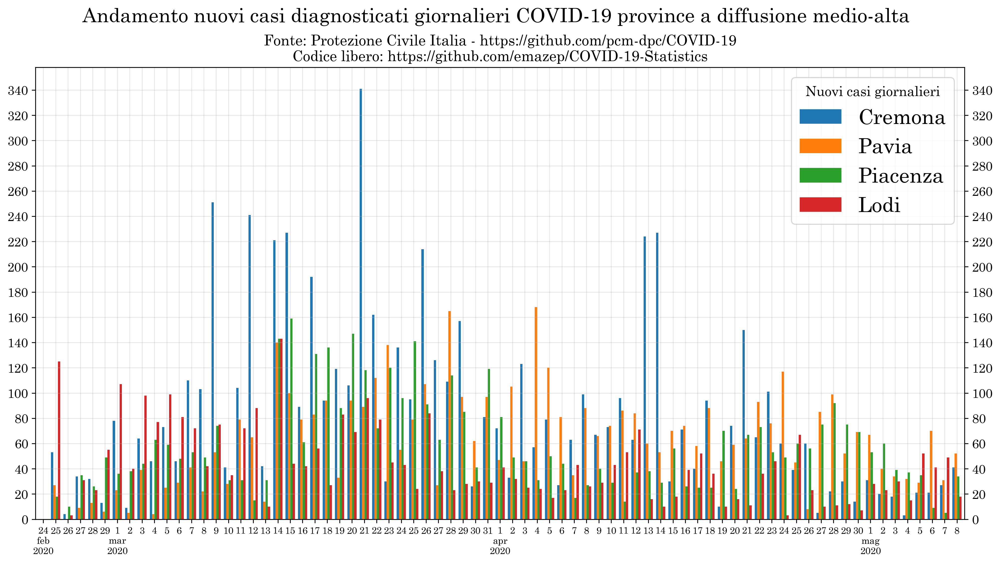

In [47]:
# Medium-high province daily incr trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Cremona', 'Pavia', 'Piacenza', 'Lodi']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ds_province_group = make_province_group_w_ra(plot_columns, days=7)

ax = ds_province_group.plot.bar(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=1, width=BAR_WIDTH)

ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates_from_numbers))
plt.xticks(rotation=0)
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(20))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)
ax.set_ylim(bottom=0)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Nuovi casi giornalieri', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 province a diffusione medio-alta', fontsize=19)

fig_daily_incr_province_medium_high = plt.gcf()

plt.show()

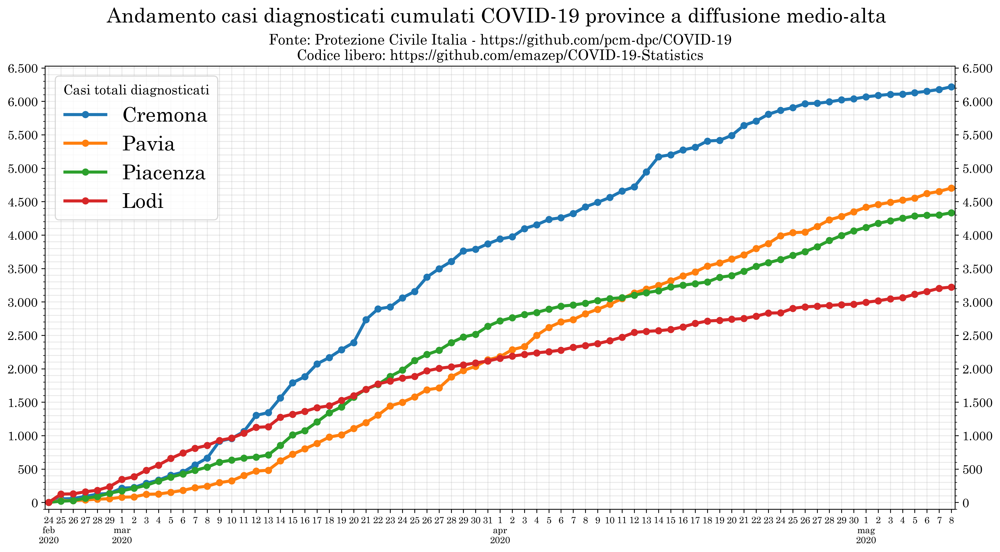

In [48]:
# Medium-high province cumulated trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Cremona', 'Pavia', 'Piacenza', 'Lodi']
COLUMN = 'totale_casi'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ax = ds_province_sided.plot(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=2, marker='o', markersize=6, linewidth=3)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_dates))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(500))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-100)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

#handles, labels = ax.get_legend_handles_labels()
#ax.legend(reversed(handles), reversed(labels), title='Casi totali diagnosticati', fontsize=24)
ax.legend(title='Casi totali diagnosticati', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento casi diagnosticati cumulati COVID-19 province a diffusione medio-alta', fontsize=20)

fig_cum_province_medium_high = plt.gcf()

plt.show()

In [49]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr.savefig('01_daily_incr_ita.png', transparent=False)
    fig_trend.savefig('02_trend_ita.png', transparent=False)
    fig_current.savefig('03_current_ita.png', transparent=False)
    fig_hospital.savefig('04_hospital_ita.png', transparent=False)
    fig_ICU.savefig('05_ICU_ita.png', transparent=False)
    fig_exitus.savefig('06_exitus_ita.png', transparent=False)
    fig_tests.savefig('07_tests_ita.png', transparent=False)
    fig_growth.savefig('08_growth_factor_ita.png', transparent=False)

In [50]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr_regions_Lombardia.savefig('09_daily_incr_Lombardia.png', transparent=False)
    fig_cum_Lombardia.savefig('10_cum_Lombardia.png', transparent=False)
    fig_tests_Lombardia.savefig('11_tests_Lombardia.png', transparent=False)
    fig_growth_Lombardia.savefig('12_growth_factor_Lombardia.png', transparent=False)

In [51]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr_regions_high.savefig('13_daily_incr_regions_high.png', transparent=False)
    fig_cum_regions_high.savefig('14_cum_regions_high.png', transparent=False)

    fig_daily_incr_regions_medium_high.savefig('15_daily_incr_regions_medium_high.png', transparent=False)
    fig_cum_regions_medium_high.savefig('16_cum_regions_medium_high.png', transparent=False)

    fig_daily_incr_regions_medium.savefig('17_daily_incr_regions_medium.png', transparent=False)
    fig_cum_regions_medium.savefig('18_cum_regions_medium.png', transparent=False)

    fig_daily_incr_regions_medium_low.savefig('19_daily_incr_regions_medium_low.png', transparent=False)
    fig_cum_regions_medium_low.savefig('20_cum_regions_medium_low.png', transparent=False)

    fig_daily_incr_regions_low.savefig('21_daily_incr_regions_low.png', transparent=False)
    fig_cum_regions_low.savefig('22_cum_regions_low.png', transparent=False)

In [52]:
with save_in_dir(OUTPUT_PATH):
    fig_density.savefig('23_density.png', transparent=False)
    fig_regional_test_RATIO.savefig('24_regional_test_RATIO.png', transparent=False)
    fig_R0.savefig('25_R0.png', transparent=False)
    fig_CFR.savefig('26_CFR.png', transparent=False)

In [53]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr_province_high.savefig('27_daily_incr_province_high.png', transparent=False)
    fig_cum_province_high.savefig('28_daily_incr_province_high.png', transparent=False)
    fig_daily_incr_province_medium_high.savefig('29_cum_province_medium_high.png', transparent=False)
    fig_cum_province_medium_high.savefig('30_cum_province_medium_high.png', transparent=False)

In [54]:
os.getcwd()

'C:\\Users\\emazep\\Dropbox\\Works\\COVID-19-Statistics\\src'